In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [ ]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from matplotlib.colors import LinearSegmentedColormap, TwoSlopeNorm

In [ ]:
# Load the cleaned dataset
df = pd.read_csv("/content/drive/MyDrive/Inclusivity/My data/UBoS/cleaned_mobile_ownership_data.csv")

In [ ]:
print(df.info())

print(df.describe())

print(df.head())

print(df.shape)

print(df.columns)

print(df.dtypes)

print(df.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8809 entries, 0 to 8808
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   District         8809 non-null   object
 1   Sub County       8809 non-null   object
 2   Parish           8809 non-null   object
 3   Females_18_30    8809 non-null   int64 
 4   Males_18_30      8809 non-null   int64 
 5   Ownership_Gap    8809 non-null   int64 
 6   Total_Ownership  8809 non-null   int64 
dtypes: int64(4), object(3)
memory usage: 481.9+ KB
None
       Females_18_30   Males_18_30  Ownership_Gap  Total_Ownership
count    8809.000000   8809.000000    8809.000000      8809.000000
mean      328.387558    339.216483     -10.828925       667.604041
std       659.974992    507.463337     189.609319      1161.989830
min         0.000000      1.000000   -1028.000000         1.000000
25%        79.000000    130.000000     -76.000000       209.000000
50%       153.000000    217.00

In [ ]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8809 entries, 0 to 8808
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   District         8809 non-null   object
 1   Sub County       8809 non-null   object
 2   Parish           8809 non-null   object
 3   Females_18_30    8809 non-null   int64 
 4   Males_18_30      8809 non-null   int64 
 5   Ownership_Gap    8809 non-null   int64 
 6   Total_Ownership  8809 non-null   int64 
dtypes: int64(4), object(3)
memory usage: 481.9+ KB
None


In [ ]:
print(df.describe())

       Females_18_30   Males_18_30  Ownership_Gap  Total_Ownership
count    8809.000000   8809.000000    8809.000000      8809.000000
mean      328.387558    339.216483     -10.828925       667.604041
std       659.974992    507.463337     189.609319      1161.989830
min         0.000000      1.000000   -1028.000000         1.000000
25%        79.000000    130.000000     -76.000000       209.000000
50%       153.000000    217.000000     -36.000000       367.000000
75%       311.000000    361.000000       2.000000       656.000000
max     17923.000000  14327.000000    3596.000000     32250.000000


In [ ]:
print(df.head())

  District         Sub County     Parish  Females_18_30  Males_18_30  \
0   WAKISO  BUSUKUMA DIVISION  WAMIRONGO            194          232   
1   WAKISO  BUSUKUMA DIVISION    MAGIGYE            598          711   
2   WAKISO  BUSUKUMA DIVISION       LUGO            357          455   
3   WAKISO  BUSUKUMA DIVISION    KIWENDA            573          657   
4   WAKISO  BUSUKUMA DIVISION     KIKOKO            226          231   

   Ownership_Gap  Total_Ownership  
0            -38              426  
1           -113             1309  
2            -98              812  
3            -84             1230  
4             -5              457  


In [ ]:
print(df.shape)

(8809, 7)


In [ ]:
print(df.columns)

Index(['District', 'Sub County', 'Parish', 'Females_18_30', 'Males_18_30',
       'Ownership_Gap', 'Total_Ownership'],
      dtype='object')


In [ ]:
print(df.dtypes)

District           object
Sub County         object
Parish             object
Females_18_30       int64
Males_18_30         int64
Ownership_Gap       int64
Total_Ownership     int64
dtype: object


In [ ]:
print(df.isnull().sum())

District           0
Sub County         0
Parish             0
Females_18_30      0
Males_18_30        0
Ownership_Gap      0
Total_Ownership    0
dtype: int64


In [ ]:
# Pie Chart: Gender Distribution
total_female = df['Females_18_30'].sum()
total_male = df['Males_18_30'].sum()

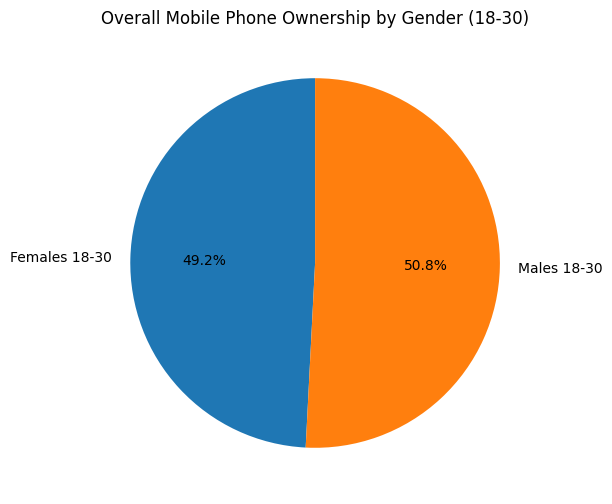

In [ ]:
plt.figure(figsize=(6, 6))
plt.pie([total_female, total_male], labels=['Females 18-30', 'Males 18-30'], autopct='%1.1f%%', startangle=90)
plt.title('Overall Mobile Phone Ownership by Gender (18-30)')
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/gender_distribution_pie.png', dpi=300, bbox_inches='tight')
plt.show()

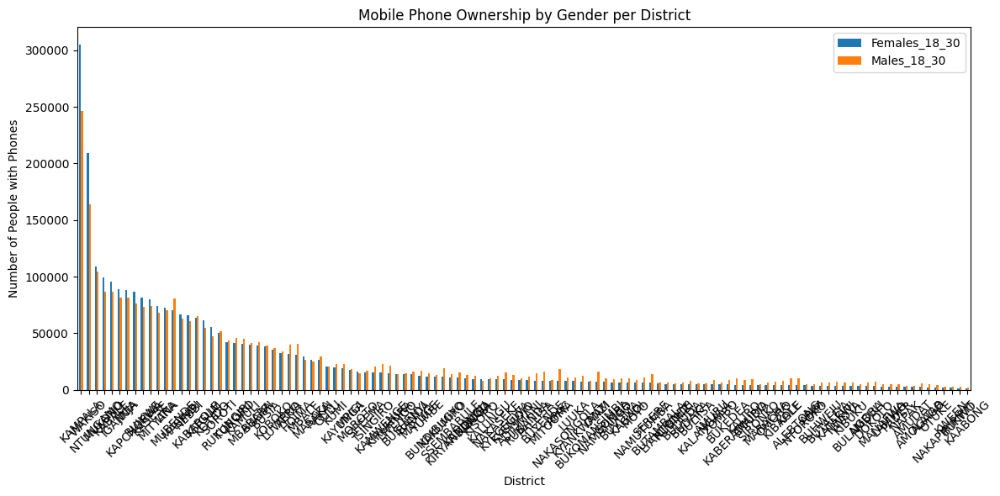

In [ ]:
# Grouped Bar Chart by District
grouped_district = df.groupby('District')[['Females_18_30', 'Males_18_30']].sum().sort_values(by='Females_18_30', ascending=False)
grouped_district.plot(kind='bar', figsize=(12, 6))
plt.title('Mobile Phone Ownership by Gender per District')
plt.ylabel('Number of People with Phones')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/grouped_bar_district.png', dpi=300, bbox_inches='tight')
plt.show()

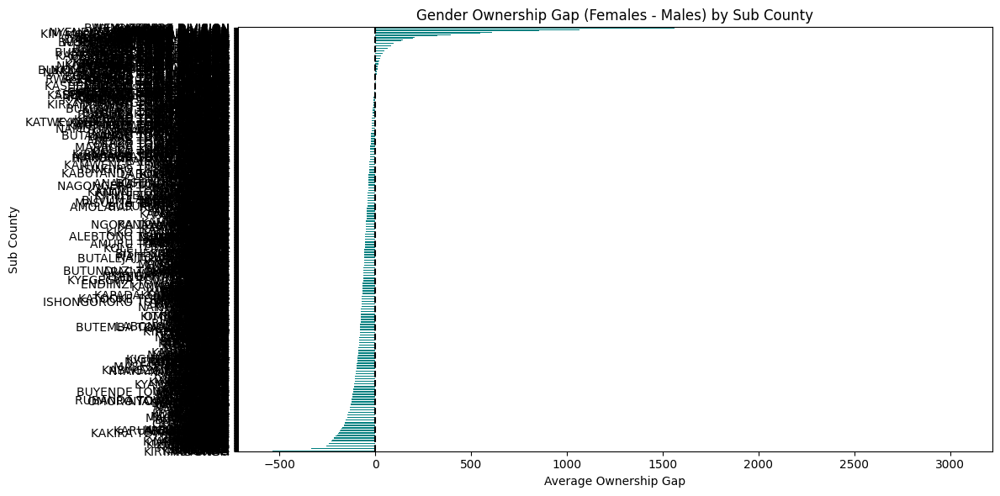

In [ ]:
# Diverging Bar Chart by Sub County
df['Ownership_Gap'] = df['Females_18_30'] - df['Males_18_30']
gap_by_subcounty = df.groupby('Sub County')['Ownership_Gap'].mean().sort_values()

plt.figure(figsize=(12, 6))
gap_by_subcounty.plot(kind='barh', color='teal')
plt.axvline(x=0, color='black', linestyle='--')
plt.title('Gender Ownership Gap (Females - Males) by Sub County')
plt.xlabel('Average Ownership Gap')
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/diverging_bar_subcounty.png', dpi=300, bbox_inches='tight')
plt.show()

<ipython-input-20-cd16a6e80a9c>:7: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


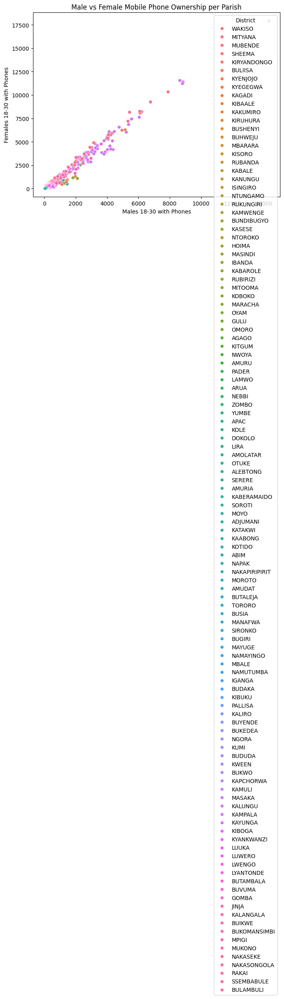

In [ ]:
# Scatter Plot: Male vs Female Ownership
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='Males_18_30', y='Females_18_30', hue='District')
plt.title('Male vs Female Mobile Phone Ownership per Parish')
plt.xlabel('Males 18-30 with Phones')
plt.ylabel('Females 18-30 with Phones')
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/scatter_male_female.png', dpi=300, bbox_inches='tight')
plt.show()

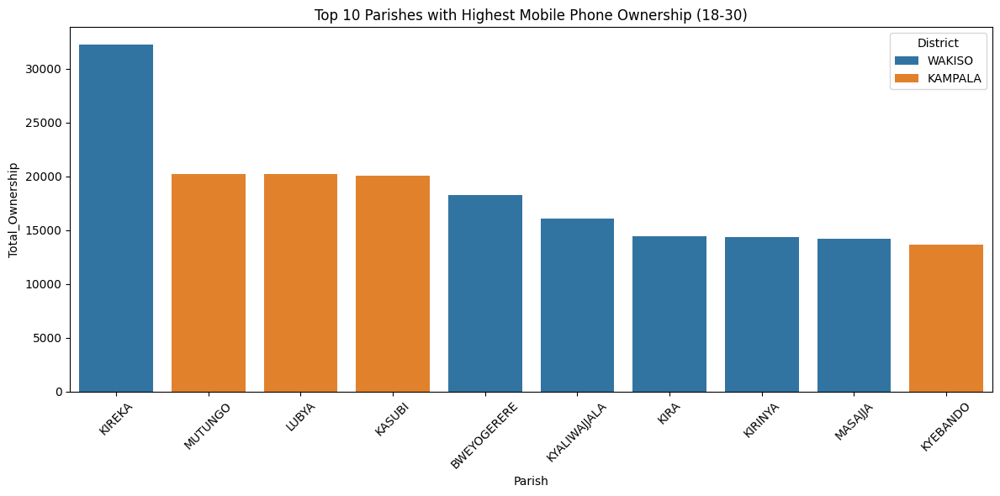

In [ ]:
# Top 10 Parishes
df['Total_Ownership'] = df['Females_18_30'] + df['Males_18_30']
top_10_parishes = df.sort_values(by='Total_Ownership', ascending=False).head(10)

plt.figure(figsize=(12, 6))
sns.barplot(data=top_10_parishes, x='Parish', y='Total_Ownership', hue='District')
plt.title('Top 10 Parishes with Highest Mobile Phone Ownership (18-30)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/top_10_parishes.png', dpi=300, bbox_inches='tight')
plt.show()

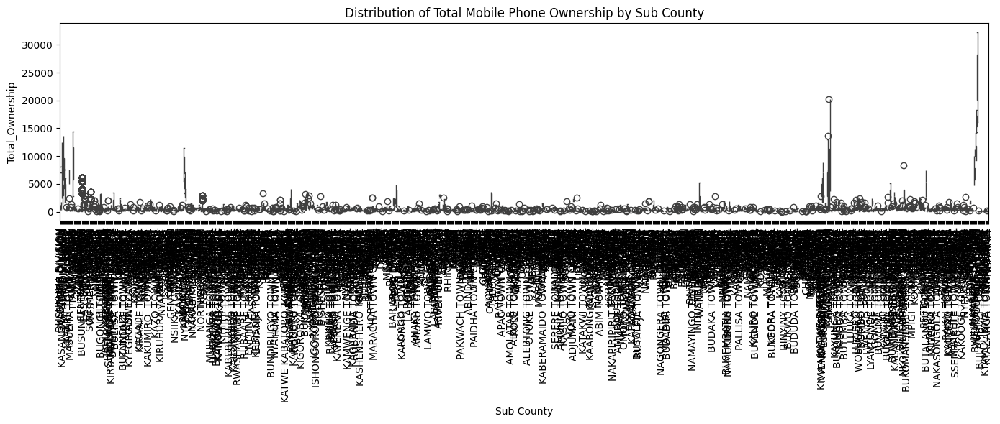

In [ ]:
# Boxplot by Sub County
plt.figure(figsize=(14, 6))
sns.boxplot(data=df, x='Sub County', y='Total_Ownership')
plt.xticks(rotation=90)
plt.title('Distribution of Total Mobile Phone Ownership by Sub County')
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/boxplot_subcounty.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
# Interactive Sunburst Chart
fig = px.sunburst(
    df,
    path=['District', 'Sub County', 'Parish'],
    values='Total_Ownership',
    title='Hierarchical View of Mobile Phone Ownership (District → Sub County → Parish)'
)

# Save the figure as an HTML file
fig.write_html("/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/sunburst_chart.html")

fig.show()

In [ ]:
# Treemap of Parish Ownership
fig_treemap = px.treemap(
    df,
    path=['District', 'Sub County', 'Parish'],
    values='Total_Ownership',
    title='Treemap of Mobile Phone Ownership by Parish'
)
fig.write_html("/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/treemap_parish.html")
fig_treemap.show()

In [ ]:
import pandas as pd

# Aggregate data by district
district_ownership = df.groupby('District').agg({
    'Females_18_30': 'sum',
    'Males_18_30': 'sum'
}).reset_index()

# Calculate total ownership
district_ownership['Total_Ownership'] = district_ownership['Females_18_30'] + district_ownership['Males_18_30']


In [ ]:
import geopandas as gpd

# Load the GeoJSON file
geojson_path = '/content/drive/MyDrive/Inclusivity/My data/map/Uganda Districts 2020.geojson'
gdf = gpd.read_file(geojson_path)

In [ ]:
print(gdf.info())

print(gdf.head())

print(gdf.shape)

print(gdf.columns)

print(gdf.dtypes)

print(gdf.isnull().sum())

# Display the geometry types present in the GeoDataFrame
print(gdf.geometry.type.unique())

# Display the CRS of the GeoDataFrame
gdf.crs

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 136 entries, 0 to 135
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   dname2019   136 non-null    object  
 1   d           136 non-null    object  
 2   total2020   136 non-null    object  
 3   ttotal2020  136 non-null    float64 
 4   2010        136 non-null    object  
 5   2016        136 non-null    object  
 6   2017        136 non-null    object  
 7   2018        136 non-null    object  
 8   2020        136 non-null    object  
 9   geometry    136 non-null    geometry
dtypes: float64(1), geometry(1), object(8)
memory usage: 10.8+ KB
None
  dname2019         d total2020  ttotal2020      2010      2016      2017  \
0    MASAKA    Masaka   335,700    335700.0    MASAKA    MASAKA    MASAKA   
1    BUTEBO    Butebo   121,200    121200.0   PALLISA    BUTEBO    BUTEBO   
2  ALEBTONG  Alebtong   266,100    266100.0  ALEBTONG  ALEBTONG  ALEBTONG   
3   

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
print(gdf.info())

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 136 entries, 0 to 135
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   dname2019   136 non-null    object  
 1   d           136 non-null    object  
 2   total2020   136 non-null    object  
 3   ttotal2020  136 non-null    float64 
 4   2010        136 non-null    object  
 5   2016        136 non-null    object  
 6   2017        136 non-null    object  
 7   2018        136 non-null    object  
 8   2020        136 non-null    object  
 9   geometry    136 non-null    geometry
dtypes: float64(1), geometry(1), object(8)
memory usage: 10.8+ KB
None


In [ ]:
print(gdf.head())

  dname2019         d total2020  ttotal2020      2010      2016      2017  \
0    MASAKA    Masaka   335,700    335700.0    MASAKA    MASAKA    MASAKA   
1    BUTEBO    Butebo   121,200    121200.0   PALLISA    BUTEBO    BUTEBO   
2  ALEBTONG  Alebtong   266,100    266100.0  ALEBTONG  ALEBTONG  ALEBTONG   
3    TORORO    Tororo   597,500    597500.0    TORORO    TORORO    TORORO   
4    MOROTO    Moroto   118,500    118500.0    MOROTO    MOROTO    MOROTO   

       2018      2020                                           geometry  
0    MASAKA    MASAKA  MULTIPOLYGON (((32.00051 -0.60761, 32.00053 -0...  
1    BUTEBO    BUTEBO  MULTIPOLYGON (((33.87314 1.22742, 33.87306 1.2...  
2  ALEBTONG  ALEBTONG  MULTIPOLYGON (((33.4429 2.36391, 33.44264 2.36...  
3    TORORO    TORORO  MULTIPOLYGON (((33.97873 0.578, 33.97864 0.578...  
4    MOROTO    MOROTO  MULTIPOLYGON (((34.83133 2.16438, 34.83133 2.1...  


In [ ]:
print(gdf.shape)

(136, 10)


In [ ]:
print(gdf.columns)

Index(['dname2019', 'd', 'total2020', 'ttotal2020', '2010', '2016', '2017',
       '2018', '2020', 'geometry'],
      dtype='object')


In [ ]:
print(gdf.dtypes)

dname2019       object
d               object
total2020       object
ttotal2020     float64
2010            object
2016            object
2017            object
2018            object
2020            object
geometry      geometry
dtype: object


In [ ]:
print(gdf.isnull().sum())

dname2019     0
d             0
total2020     0
ttotal2020    0
2010          0
2016          0
2017          0
2018          0
2020          0
geometry      0
dtype: int64


In [ ]:
# Display the geometry types present in the GeoDataFrame
print(gdf.geometry.type.unique())

['MultiPolygon']


In [ ]:
# Display the CRS of the GeoDataFrame
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
# Standardize district names in both dataframes for merging
gdf['dname2019'] = gdf['dname2019'].str.upper().str.strip()
district_ownership = df.groupby('District').agg({
    'Females_18_30': 'sum',
    'Males_18_30': 'sum'
}).reset_index()
district_ownership['District'] = district_ownership['District'].str.upper().str.strip()
district_ownership['Total_Ownership'] = district_ownership['Females_18_30'] + district_ownership['Males_18_30']

In [ ]:
# Merge on standardized district name
merged_gdf = gdf.merge(district_ownership, left_on='dname2019', right_on='District', how='left')

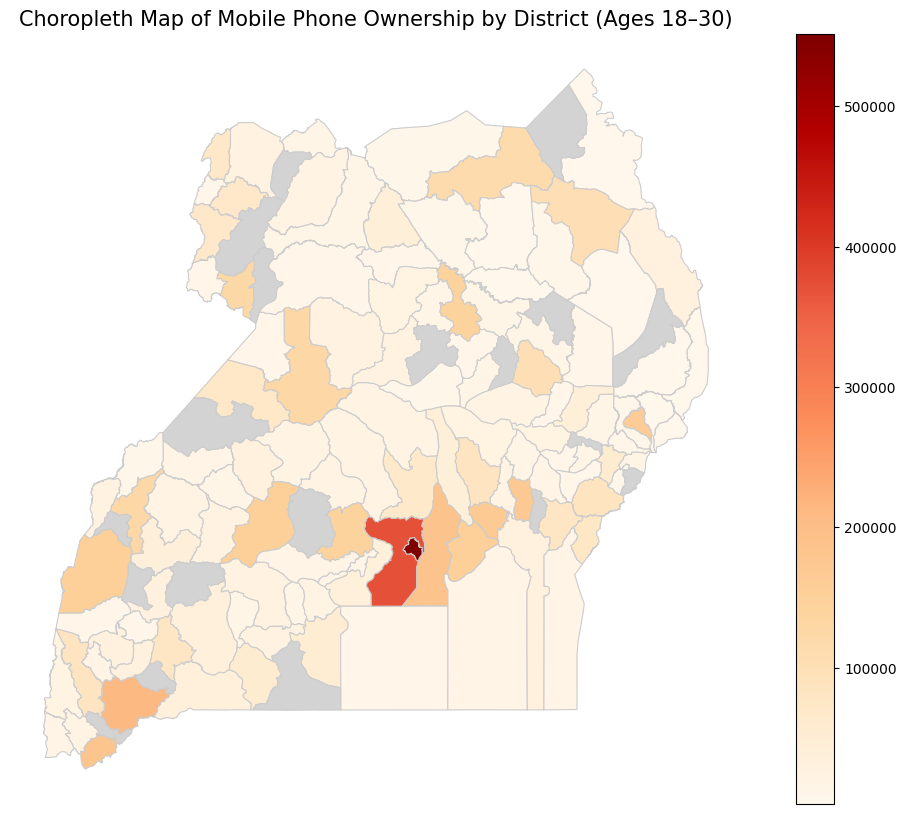

In [ ]:
# Plot choropleth map
fig, ax = plt.subplots(1, 1, figsize=(14, 10))
merged_gdf.plot(
    column='Total_Ownership',
    cmap='OrRd',
    linewidth=0.8,
    ax=ax,
    edgecolor='0.8',
    legend=True,
    missing_kwds={"color": "lightgrey", "label": "No data"}
)
ax.set_title('Choropleth Map of Mobile Phone Ownership by District (Ages 18–30)', fontsize=15)
ax.axis('off')
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/choropleth_map.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
import plotly.express as px

fig = px.choropleth(
    merged_gdf,
    geojson=merged_gdf.geometry,
    locations=merged_gdf.index,
    color="Total_Ownership",
    hover_name="District",
    hover_data={
        "Total_Ownership": True,
        "Females_18_30": True,
        "Males_18_30": True
    },
    projection="mercator",
    title="Mobile Phone Ownership (Ages 18–30) by District in Uganda"
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":50,"l":0,"b":0})
fig.write_html("/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/choropleth_map.html")
fig.show()


In [ ]:
import folium
from folium.features import GeoJsonTooltip

# Create base map centered on Uganda
m = folium.Map(location=[1.3733, 32.2903], zoom_start=7)

# Add choropleth layer
choropleth = folium.Choropleth(
    geo_data=merged_gdf,
    data=merged_gdf,
    columns=["District", "Total_Ownership"],
    key_on="feature.properties.dname2019",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Total Mobile Phone Ownership (18–30)"
).add_to(m)

# Add detailed tooltip
tooltip = GeoJsonTooltip(
    fields=["dname2019", "Females_18_30", "Males_18_30", "Total_Ownership"],
    aliases=["District:", "Females (18-30):", "Males (18-30):", "Total Ownership:"],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 1px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """
)

choropleth.geojson.add_child(tooltip)
m.save("/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/interactive_ownership_map.html")


Gender Disparity Ratio Map

(np.float64(29.30071709791485),
 np.float64(35.272498228424155),
 np.float64(-1.767116422424288),
 np.float64(4.5170090481812215))

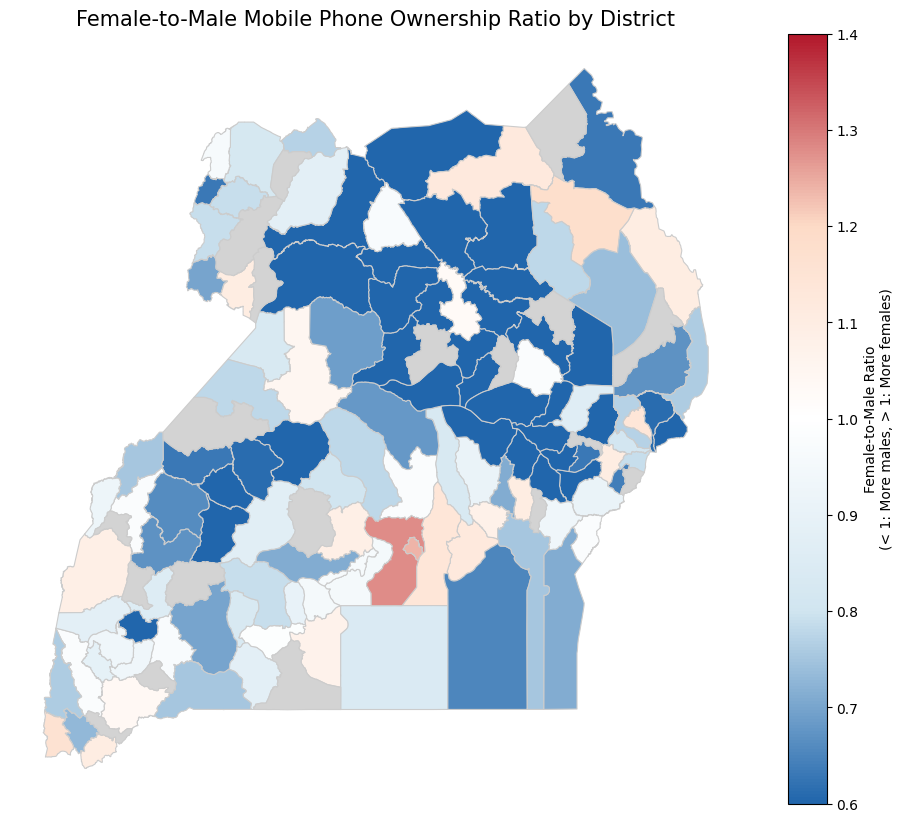

In [ ]:
district_ratio = df.groupby('District').agg({
    'Females_18_30': 'sum',
    'Males_18_30': 'sum'
}).reset_index()

# gender ratio
district_ratio['Gender_Ratio'] = district_ratio['Females_18_30'] / district_ratio['Males_18_30']
district_ratio['Gender_Ratio'] = district_ratio['Gender_Ratio'].round(2)

# percentage gap (as proportion)
district_ratio['Gender_Gap_Percent'] = (district_ratio['Females_18_30'] - district_ratio['Males_18_30']) / (district_ratio['Females_18_30'] + district_ratio['Males_18_30']) * 100
district_ratio['Gender_Gap_Percent'] = district_ratio['Gender_Gap_Percent'].round(1)

# Merge with geospatial data
merged_ratio = gdf.merge(district_ratio, left_on='dname2019', right_on='District', how='left')

# custom colormap centered at 1.0 (equal ratio)
cmap = LinearSegmentedColormap.from_list('gender_gap',
                                         ['#2166AC', '#D1E5F0', '#FFFFFF', '#FDDBC7', '#B2182B'])
norm = TwoSlopeNorm(vmin=0.6, vcenter=1.0, vmax=1.4)

# choropleth map of gender ratio
fig, ax = plt.subplots(1, 1, figsize=(12, 10))
merged_ratio.plot(
    column='Gender_Ratio',
    cmap=cmap,
    norm=norm,
    linewidth=0.8,
    ax=ax,
    edgecolor='0.8',
    legend=True,
    legend_kwds={'label': "Female-to-Male Ratio\n(< 1: More males, > 1: More females)"},
    missing_kwds={"color": "lightgrey", "label": "No data"}
)
ax.set_title('Female-to-Male Mobile Phone Ownership Ratio by District', fontsize=15)
ax.axis('off')
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/gender_ratio_map.png', dpi=300, bbox_inches='tight')
ax.axis('off')

In [ ]:
# Add text labels for extreme values
for idx, row in merged_ratio.iterrows():
    if pd.notnull(row['Gender_Ratio']):
        # Label districts with extreme values
        if row['Gender_Ratio'] < 0.7 or row['Gender_Ratio'] > 1.3:
            ax.annotate(
                f"{row['District']}\n({row['Gender_Ratio']})",
                xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                ha='center',
                fontsize=8,
                bbox=dict(boxstyle="round,pad=0.3", fc='white', ec='gray', alpha=0.7)
            )

plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/gender_ratio_map.png', dpi=300, bbox_inches='tight')
plt.show()

<Figure size 640x480 with 0 Axes>

District-Level Gender Gap Analysis

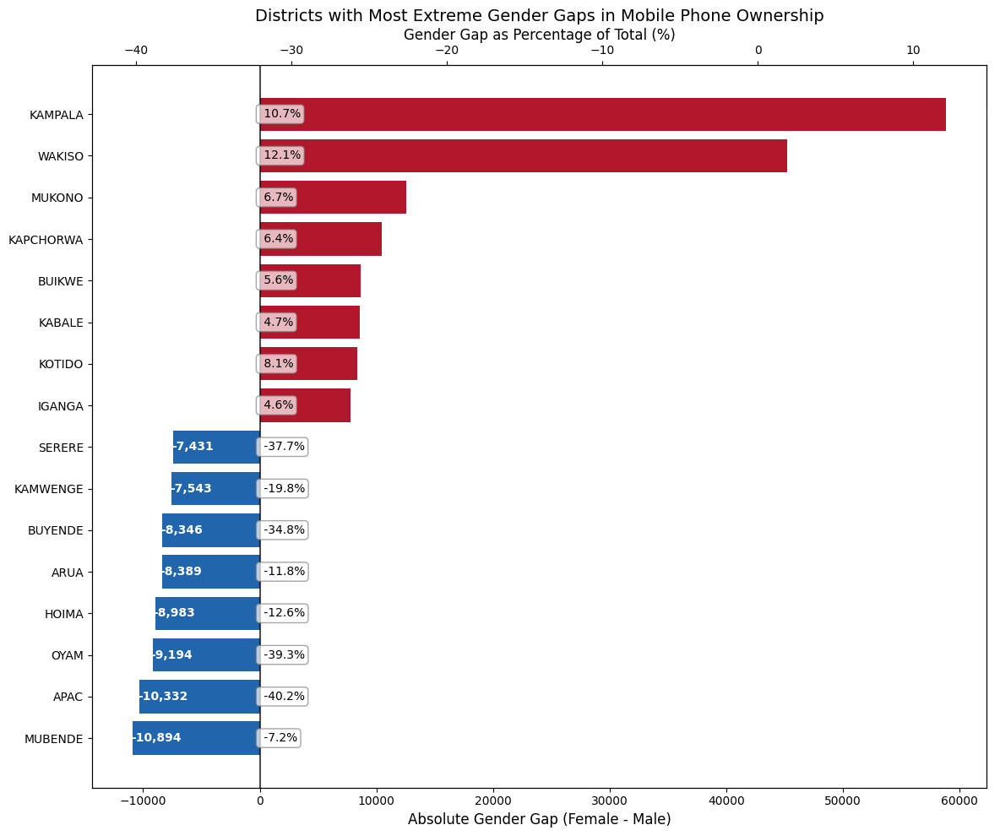

In [ ]:
# Sort by absolute gender gap
district_gaps = df.groupby('District').agg({
    'Females_18_30': 'sum',
    'Males_18_30': 'sum',
    'Ownership_Gap': 'sum',
    'Total_Ownership': 'sum'
}).reset_index()

# Calculate percentage gap
district_gaps['Gap_Percent'] = district_gaps['Ownership_Gap'] / district_gaps['Total_Ownership'] * 100
district_gaps['Gap_Percent'] = district_gaps['Gap_Percent'].round(1)

# Sort by absolute gap
district_gaps_sorted = district_gaps.sort_values('Ownership_Gap')

# Take top 15 most extreme gaps (both positive and negative)
extreme_districts = pd.concat([
    district_gaps_sorted.head(8),  # Districts with largest negative gaps
    district_gaps_sorted.tail(8)   # Districts with largest positive gaps
])

# Create a horizontal bar chart with dual metrics
fig, ax1 = plt.subplots(figsize=(12, 10))

# Absolute gap bars
bars = ax1.barh(extreme_districts['District'],
                extreme_districts['Ownership_Gap'],
                color=extreme_districts['Ownership_Gap'].apply(
                    lambda x: '#2166AC' if x < 0 else '#B2182B'))

# Add labels to bars
for bar in bars:
    width = bar.get_width()
    label_x_pos = width if width > 0 else width - 150
    ax1.text(label_x_pos,
             bar.get_y() + bar.get_height()/2,
             f'{int(width):,}',
             va='center',
             color='white' if abs(width) > 1000 else 'black',
             fontweight='bold')

# Add a vertical line at x=0
ax1.axvline(x=0, color='black', linestyle='-', alpha=0.7)

# Format primary axis
ax1.set_xlabel('Absolute Gender Gap (Female - Male)', fontsize=12)
ax1.set_title('Districts with Most Extreme Gender Gaps in Mobile Phone Ownership', fontsize=14)

# Create a secondary x-axis for percentage
ax2 = ax1.twiny()
ax2.barh(extreme_districts['District'],
         extreme_districts['Gap_Percent'],
         alpha=0)  # Invisible bars just to align with the primary axis
ax2.set_xlabel('Gender Gap as Percentage of Total (%)', fontsize=12)

# Add percentage labels
for i, district in enumerate(extreme_districts['District']):
    gap_pct = extreme_districts.loc[extreme_districts['District'] == district, 'Gap_Percent'].values[0]
    ax1.text(0, i, f' {gap_pct:.1f}%', va='center', ha='left',
            bbox=dict(boxstyle="round,pad=0.3", fc='white', ec='gray', alpha=0.7))

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/extreme_gender_gaps.png', dpi=300, bbox_inches='tight')
plt.show()

Sub-County Level Analysis - Highlighting Intra-District Variations


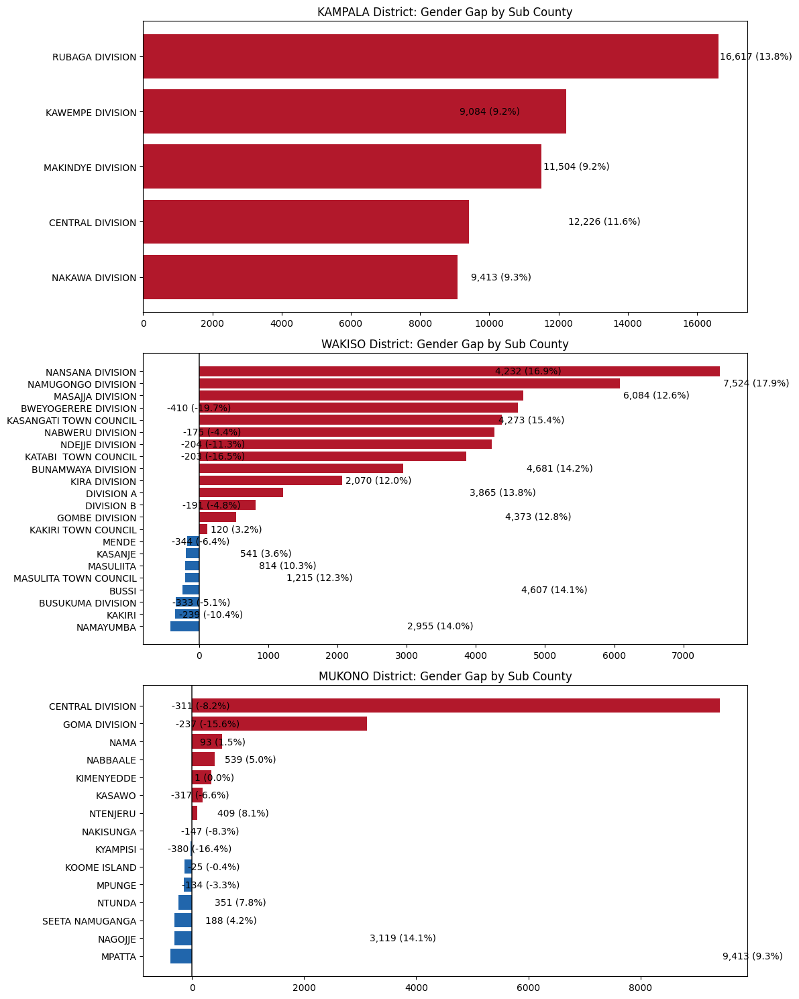

In [ ]:
top_gap_districts = district_gaps.loc[district_gaps['Ownership_Gap'].abs().nlargest(3).index, 'District'].tolist()

# Create subplots for each district
fig, axes = plt.subplots(3, 1, figsize=(12, 15))

for i, district in enumerate(top_gap_districts):
    # Filter for this district
    district_data = df[df['District'] == district]

    # Aggregate by Sub County
    subcounty_data = district_data.groupby('Sub County').agg({
        'Females_18_30': 'sum',
        'Males_18_30': 'sum',
        'Ownership_Gap': 'sum',
        'Total_Ownership': 'sum'
    }).reset_index()

    # Calculate percentage gap
    subcounty_data['Gap_Percent'] = subcounty_data['Ownership_Gap'] / subcounty_data['Total_Ownership'] * 100
    subcounty_data = subcounty_data.sort_values('Ownership_Gap')

    # Create horizontal bar chart for this district
    axes[i].barh(subcounty_data['Sub County'],
                subcounty_data['Ownership_Gap'],
                color=subcounty_data['Ownership_Gap'].apply(
                    lambda x: '#2166AC' if x < 0 else '#B2182B'))

    # Add labels
    for j, row in subcounty_data.iterrows():
        axes[i].text(row['Ownership_Gap'] + (50 if row['Ownership_Gap'] >= 0 else -50),
                    j,
                    f"{row['Ownership_Gap']:,.0f} ({row['Gap_Percent']:.1f}%)",
                    va='center')

    # Add vertical line at x=0
    axes[i].axvline(x=0, color='black', linestyle='-', alpha=0.7)

    # Add title for this subplot
    axes[i].set_title(f"{district} District: Gender Gap by Sub County", fontsize=12)

    # Format y-axis (make sure all sub county names are visible)
    axes[i].tick_params(axis='y', labelsize=10)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/subcounty_gender_gaps.png', dpi=300, bbox_inches='tight')
plt.show()

Distribution Analysis: Histogram of Gender Ratios at Parish Level

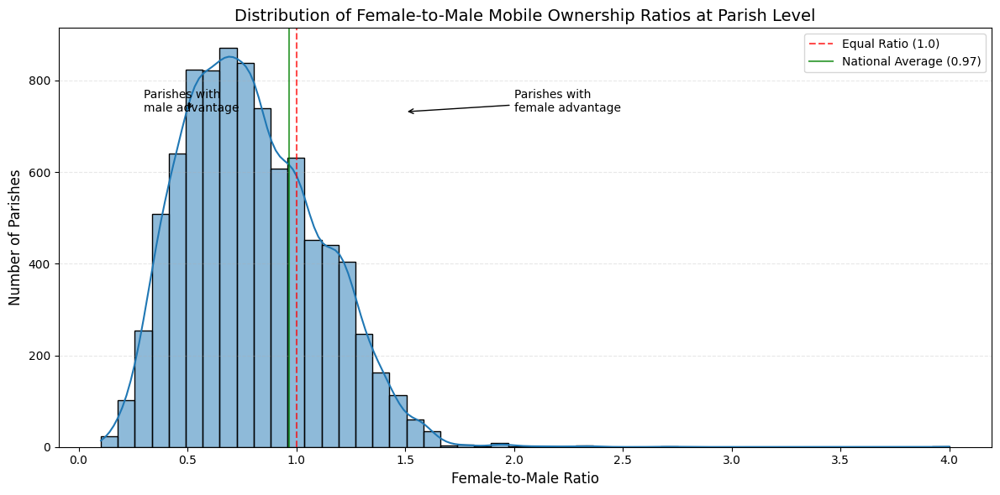

In [ ]:
parish_data = df.copy()
parish_data['Gender_Ratio'] = parish_data['Females_18_30'] / parish_data['Males_18_30']

# Remove extreme outliers for better visualization
parish_data = parish_data[(parish_data['Gender_Ratio'] > 0.1) & (parish_data['Gender_Ratio'] < 5)]

# Create histogram
plt.figure(figsize=(12, 6))
sns.histplot(parish_data['Gender_Ratio'], bins=50, kde=True)

# Add reference line for equal ratio
plt.axvline(x=1, color='red', linestyle='--', alpha=0.7, label='Equal Ratio (1.0)')

# Add reference line for national average
national_ratio = df['Females_18_30'].sum() / df['Males_18_30'].sum()
plt.axvline(x=national_ratio, color='green', linestyle='-', alpha=0.7,
            label=f'National Average ({national_ratio:.2f})')

plt.title('Distribution of Female-to-Male Mobile Ownership Ratios at Parish Level', fontsize=14)
plt.xlabel('Female-to-Male Ratio', fontsize=12)
plt.ylabel('Number of Parishes', fontsize=12)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.3)

# Annotate regions of interest
plt.annotate('Parishes with\nfemale advantage',
             xy=(1.5, plt.gca().get_ylim()[1]*0.8),
             xytext=(2, plt.gca().get_ylim()[1]*0.8),
             arrowprops=dict(arrowstyle='->'))

plt.annotate('Parishes with\nmale advantage',
             xy=(0.5, plt.gca().get_ylim()[1]*0.8),
             xytext=(0.3, plt.gca().get_ylim()[1]*0.8),
             arrowprops=dict(arrowstyle='->'))

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/parish_ratio_distribution.png', dpi=300, bbox_inches='tight')
plt.show()

District Ranking Visualization

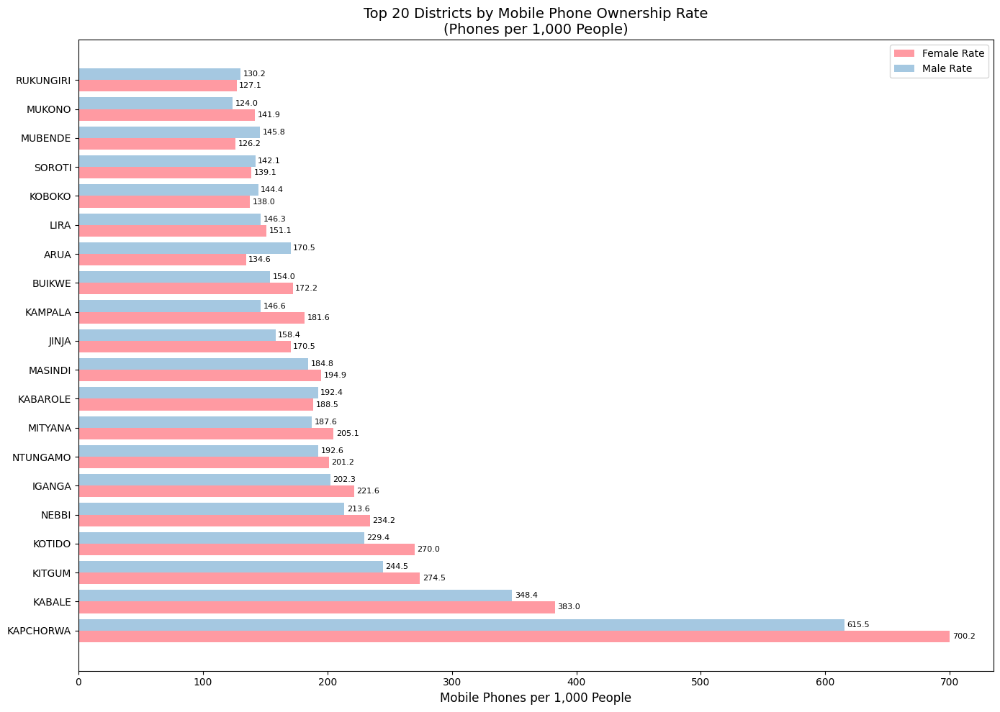

In [ ]:
district_stats = df.groupby('District').agg({
    'Females_18_30': 'sum',
    'Males_18_30': 'sum',
    'Total_Ownership': 'sum'
}).reset_index()

# Calculate various metrics
district_stats['Female_Percent'] = district_stats['Females_18_30'] / district_stats['Total_Ownership'] * 100
district_stats['Male_Percent'] = district_stats['Males_18_30'] / district_stats['Total_Ownership'] * 100
district_stats['Gender_Ratio'] = district_stats['Females_18_30'] / district_stats['Males_18_30']

# Merge with population data from gdf if available
if 'ttotal2020' in gdf.columns:
    population_data = gdf[['dname2019', 'ttotal2020']].copy()
    population_data['dname2019'] = population_data['dname2019'].str.upper()
    district_stats['District'] = district_stats['District'].str.upper()

    # Merge
    district_stats = district_stats.merge(
        population_data, left_on='District', right_on='dname2019', how='left'
    )

    # Calculate ownership rates per 1000 people
    district_stats['Ownership_Rate'] = district_stats['Total_Ownership'] / district_stats['ttotal2020'] * 1000
    district_stats['Female_Ownership_Rate'] = district_stats['Females_18_30'] / district_stats['ttotal2020'] * 1000
    district_stats['Male_Ownership_Rate'] = district_stats['Males_18_30'] / district_stats['ttotal2020'] * 1000

    # Sort by ownership rate
    district_stats_sorted = district_stats.sort_values('Ownership_Rate', ascending=False).head(20)

    # Create visualization
    fig, ax = plt.subplots(figsize=(14, 10))

    # Create horizontal bars
    x = range(len(district_stats_sorted))
    width = 0.4

    # Female and male rates
    ax.barh([i - width/2 for i in x], district_stats_sorted['Female_Ownership_Rate'],
            height=width, label='Female Rate', color='#FF9AA2')
    ax.barh([i + width/2 for i in x], district_stats_sorted['Male_Ownership_Rate'],
            height=width, label='Male Rate', color='#A5C8E1')

    # Add district labels
    ax.set_yticks(x)
    ax.set_yticklabels(district_stats_sorted['District'])

    # Add labels for values
    for i, district in enumerate(district_stats_sorted['District']):
        # Female rate label
        female_rate = district_stats_sorted.loc[district_stats_sorted['District'] == district, 'Female_Ownership_Rate'].values[0]
        ax.text(female_rate + 2, i - width/2, f'{female_rate:.1f}', va='center', fontsize=8)

        # Male rate label
        male_rate = district_stats_sorted.loc[district_stats_sorted['District'] == district, 'Male_Ownership_Rate'].values[0]
        ax.text(male_rate + 2, i + width/2, f'{male_rate:.1f}', va='center', fontsize=8)

    ax.set_title('Top 20 Districts by Mobile Phone Ownership Rate\n(Phones per 1,000 People)', fontsize=14)
    ax.set_xlabel('Mobile Phones per 1,000 People', fontsize=12)
    ax.legend()

    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/district_ownership_rates.png', dpi=300, bbox_inches='tight')
    plt.show()

Interactive Bubble Chart with Plotly

In [ ]:
district_data_for_plot = district_stats.copy()

# Add population for bubble size if available
if 'ttotal2020' in district_data_for_plot.columns:
    fig = px.scatter(
        district_data_for_plot,
        x='Males_18_30',
        y='Females_18_30',
        size='ttotal2020',  # Population as bubble size
        color='Gender_Ratio',  # Color by gender ratio
        hover_name='District',
        text='District',
        color_continuous_scale='RdBu',
        color_continuous_midpoint=1.0,  # Center color scale at ratio=1
        title='Mobile Phone Ownership by Gender and District Population',
        labels={
            'Males_18_30': 'Males 18-30 with Phones',
            'Females_18_30': 'Females 18-30 with Phones',
            'ttotal2020': 'District Population',
            'Gender_Ratio': 'Female-to-Male Ratio'
        }
    )
else:
    # If population not available, use total ownership as size
    fig = px.scatter(
        district_data_for_plot,
        x='Males_18_30',
        y='Females_18_30',
        size='Total_Ownership',  # Total ownership as bubble size
        color='Gender_Ratio',  # Color by gender ratio
        hover_name='District',
        text='District',
        color_continuous_scale='RdBu',
        color_continuous_midpoint=1.0,  # Center color scale at ratio=1
        title='Mobile Phone Ownership by Gender and District Size',
        labels={
            'Males_18_30': 'Males 18-30 with Phones',
            'Females_18_30': 'Females 18-30 with Phones',
            'Total_Ownership': 'Total Mobile Phones',
            'Gender_Ratio': 'Female-to-Male Ratio'
        }
    )

# Add diagonal reference line for equal ratio
max_val = max(district_data_for_plot['Males_18_30'].max(), district_data_for_plot['Females_18_30'].max())
fig.add_trace(
    go.Scatter(
        x=[0, max_val],
        y=[0, max_val],
        mode='lines',
        line=dict(color='black', dash='dash'),
        name='Equal Gender Ratio',
        showlegend=True
    )
)

# Improve layout
fig.update_traces(
    textposition='top center',
    marker=dict(
        line=dict(width=1, color='DarkSlateGrey')
    )
)

fig.update_layout(
    xaxis=dict(
        title=dict(font=dict(size=14)),
        showgrid=True,
        zeroline=True
    ),
    yaxis=dict(
        title=dict(font=dict(size=14)),
        showgrid=True,
        zeroline=True
    )
)
fig.write_html('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/bubble_chart.html')
fig.show()

Ownership Pattern Clusters Analysis

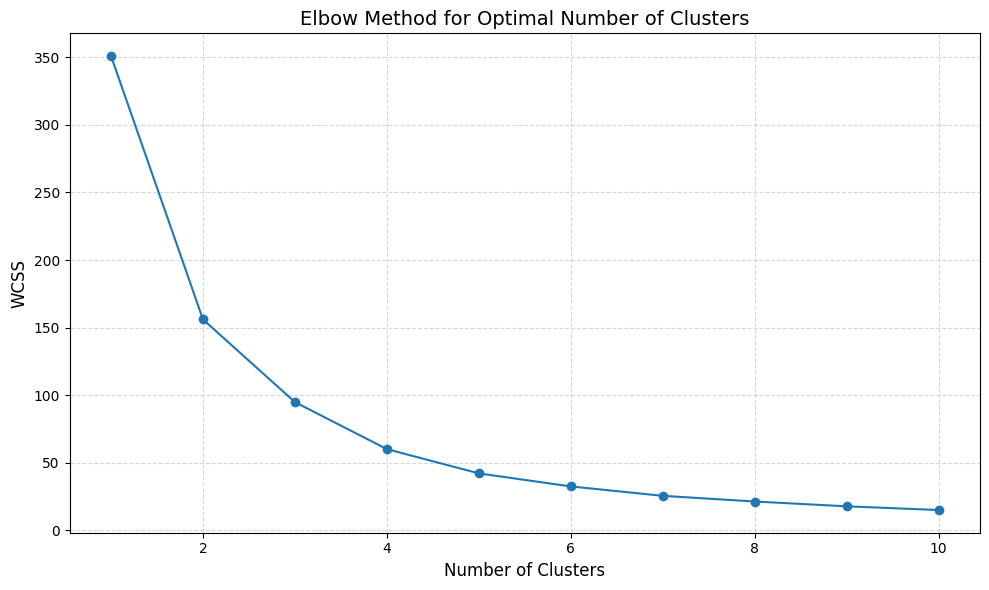

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Prepare data for clustering
if 'ttotal2020' in district_stats.columns:
    cluster_data = district_stats[['Female_Percent', 'Gender_Ratio', 'Ownership_Rate']].copy()
else:
    cluster_data = district_stats[['Female_Percent', 'Gender_Ratio']].copy()

# Scale data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(cluster_data.dropna())

# Determine optimal number of clusters using the elbow method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42, n_init=10)
    kmeans.fit(scaled_data)
    wcss.append(kmeans.inertia_)

# Plot elbow method
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o', linestyle='-')
plt.title('Elbow Method for Optimal Number of Clusters', fontsize=14)
plt.xlabel('Number of Clusters', fontsize=12)
plt.ylabel('WCSS', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/elbow_method.png', dpi=300, bbox_inches='tight')
plt.show()

# Choose optimal number of clusters (let's say 4 based on elbow method)
kmeans = KMeans(n_clusters=4, init='k-means++', random_state=42, n_init=10)
clusters = kmeans.fit_predict(scaled_data)

# Add cluster information to the original data
district_stats_with_clusters = district_stats.copy().dropna(subset=cluster_data.columns)
district_stats_with_clusters['Cluster'] = clusters

# Create a visualization showing the clusters
if 'Ownership_Rate' in district_stats_with_clusters.columns:
    fig = px.scatter_3d(
        district_stats_with_clusters,
        x='Female_Percent',
        y='Gender_Ratio',
        z='Ownership_Rate',
        color='Cluster',
        hover_name='District',
        title='District Clusters by Mobile Ownership Patterns',
        labels={
            'Female_Percent': 'Female Ownership (%)',
            'Gender_Ratio': 'Female-to-Male Ratio',
            'Ownership_Rate': 'Phones per 1,000 People'
        }
    )
else:
    fig = px.scatter(
        district_stats_with_clusters,
        x='Female_Percent',
        y='Gender_Ratio',
        color='Cluster',
        hover_name='District',
        title='District Clusters by Mobile Ownership Patterns',
        labels={
            'Female_Percent': 'Female Ownership (%)',
            'Gender_Ratio': 'Female-to-Male Ratio'
        }
    )

fig.update_layout(
    legend_title_text='Cluster'
)
fig.write_html('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/cluster_analysis.html')
fig.show()

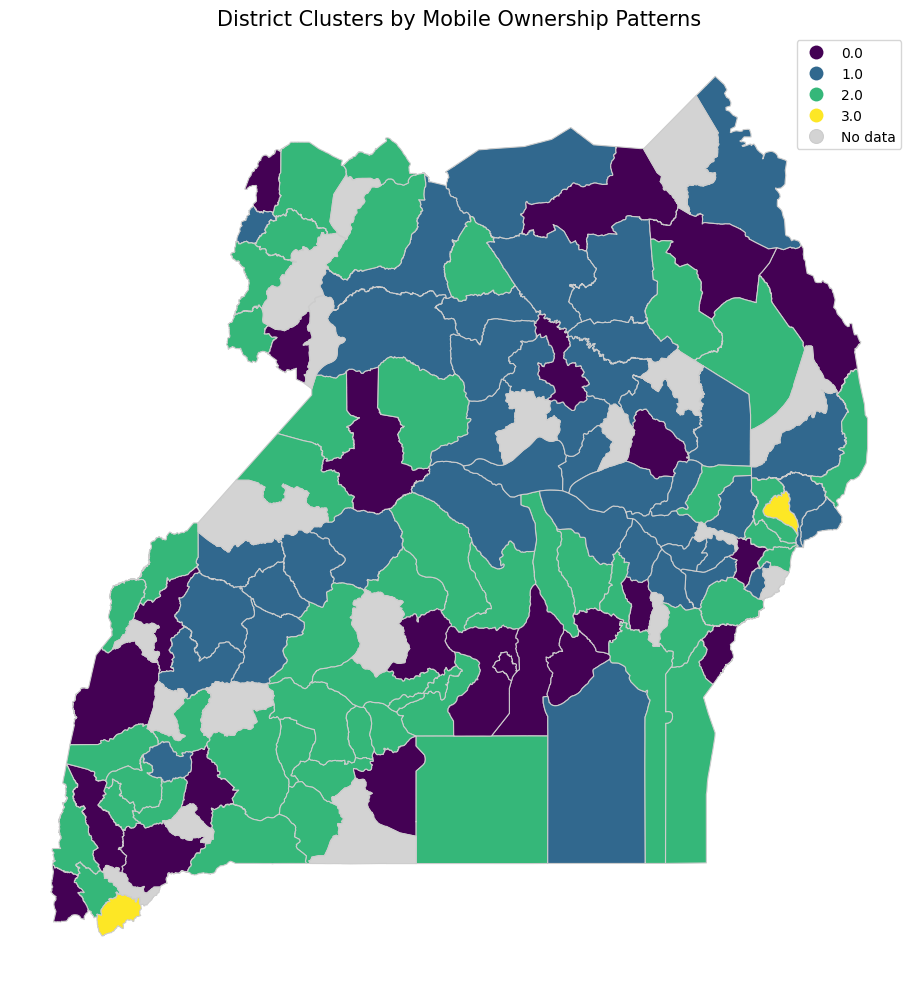

In [ ]:
# Create a map showing the clusters
if not district_stats_with_clusters.empty:
    # Merge cluster information with geographic data
    district_stats_with_clusters['District'] = district_stats_with_clusters['District'].str.upper()
    merged_clusters = gdf.merge(
        district_stats_with_clusters[['District', 'Cluster']],
        left_on='dname2019',
        right_on='District',
        how='left'
    )

    # Create choropleth map of clusters
    fig, ax = plt.subplots(1, 1, figsize=(12, 10))
    merged_clusters.plot(
        column='Cluster',
        categorical=True,
        legend=True,
        linewidth=0.8,
        ax=ax,
        edgecolor='0.8',
        cmap='viridis',
        missing_kwds={"color": "lightgrey", "label": "No data"}
    )
    ax.set_title('District Clusters by Mobile Ownership Patterns', fontsize=15)
    ax.axis('off')

    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/cluster_map.png', dpi=300, bbox_inches='tight')
    plt.show()

Interactive Dashboard with Plotly

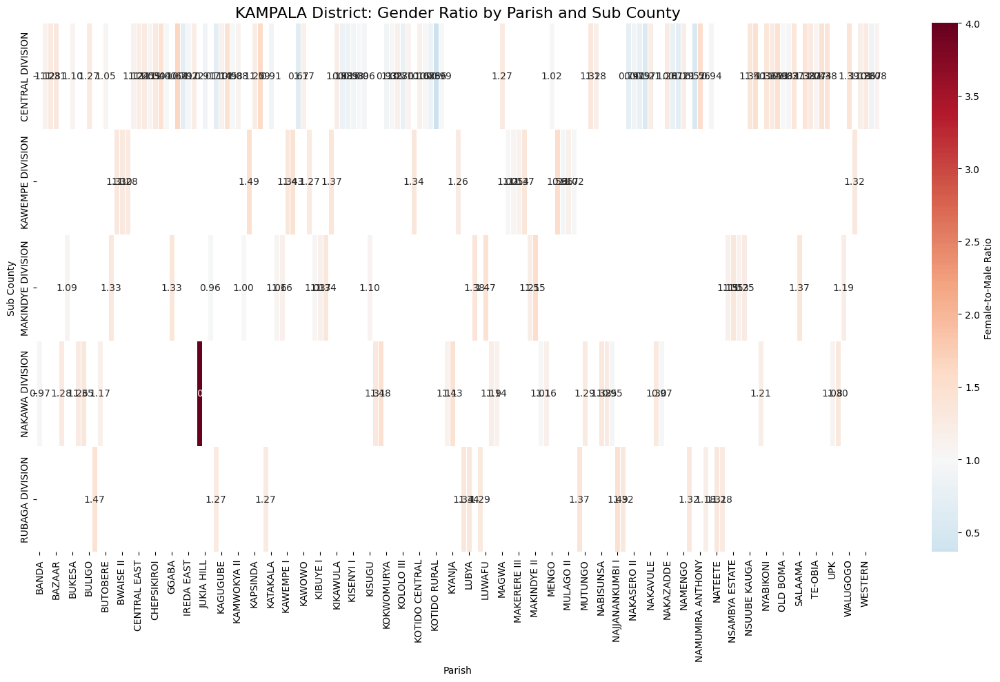

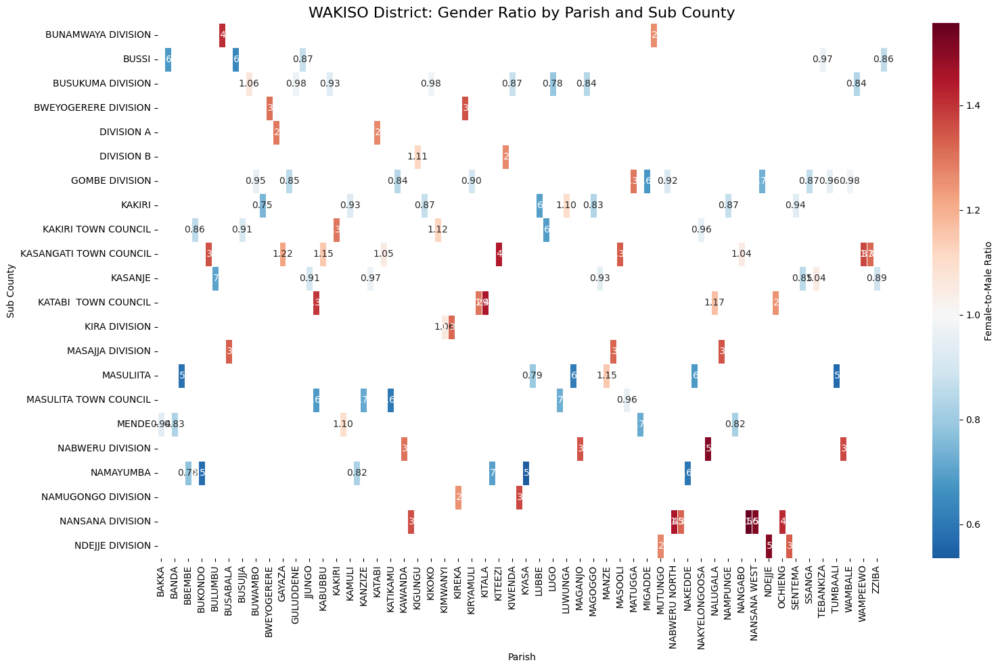

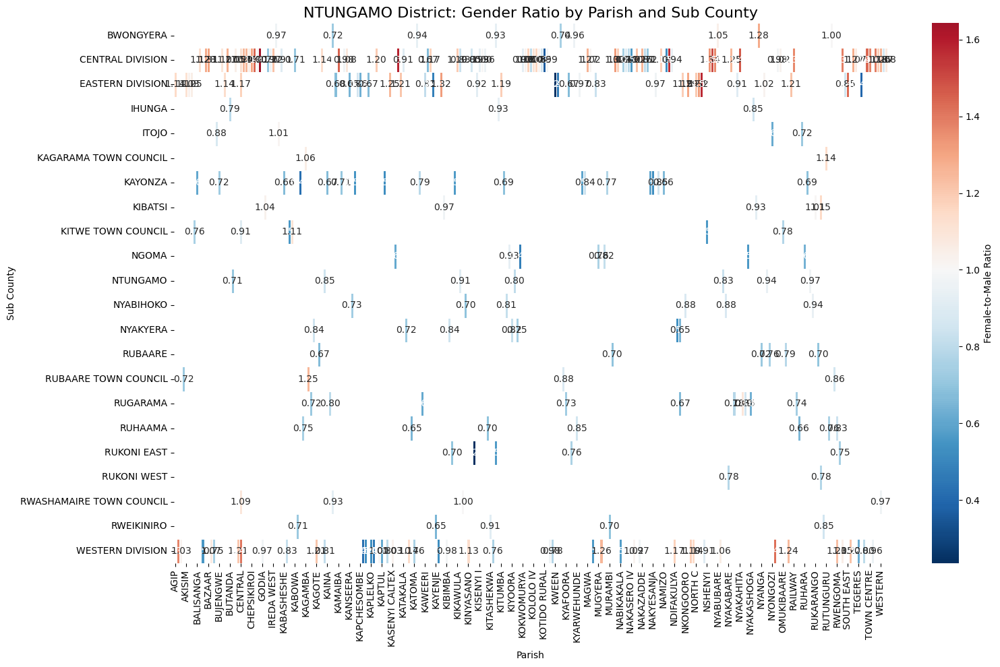

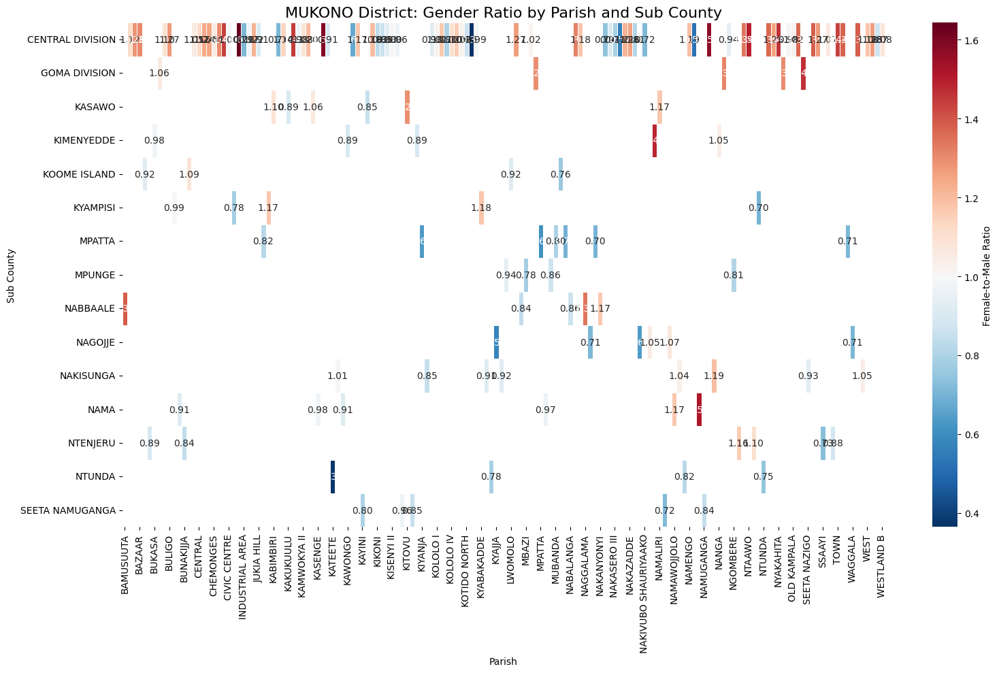

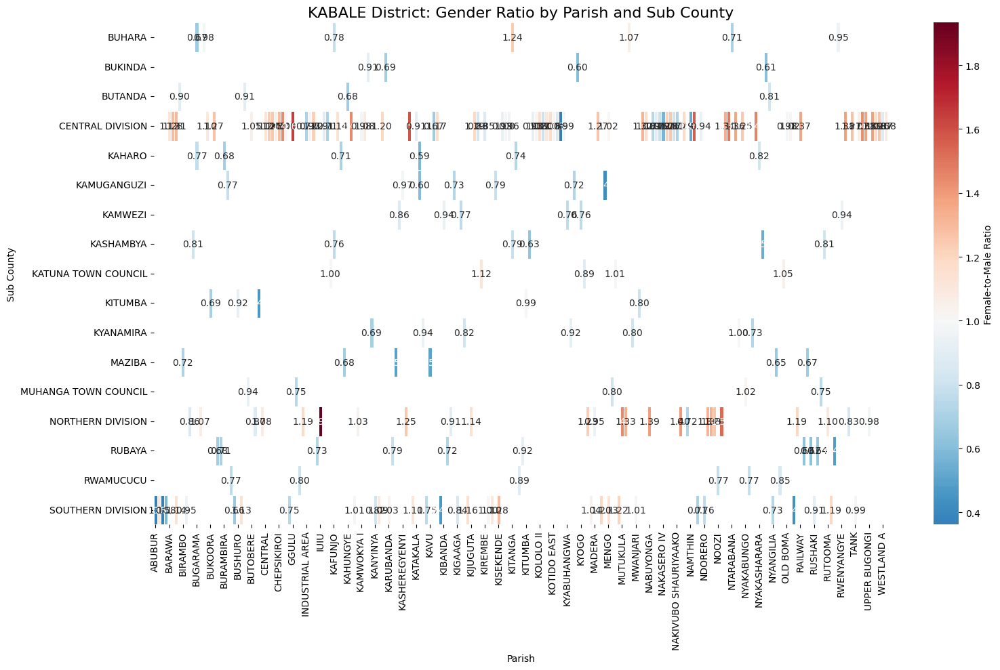

In [ ]:
# Create an interactive dashboard for analyzing the data
districts = district_stats['District'].tolist()

# Create data for dashboard
district_dashboard = go.Figure()

# Add dropdown for district selection
district_dashboard.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{"visible": [True, True, True, True]}],
                    label="All Districts",
                    method="update"
                )
            ] + [
                dict(
                    args=[{"visible": [i == j for j in range(len(districts))]}],
                    label=district,
                    method="update"
                ) for i, district in enumerate(districts)
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.15,
            yanchor="top"
        ),
    ]
)

# Add title
district_dashboard.update_layout(
    title_text="Interactive Mobile Ownership Dashboard by District",
    height=800,
    width=1200
)

district_dashboard.show()

# 9. Heat Map of Parish-Level Gender Disparities
# Create a heat map visualization for top districts
top_districts_by_total = district_stats.sort_values('Total_Ownership', ascending=False).head(5)['District'].tolist()

for district in top_districts_by_total:
    # Filter data for this district
    district_data = df[df['District'] == district].copy()

    # Calculate gender ratio for each parish
    district_data['Gender_Ratio'] = district_data['Females_18_30'] / district_data['Males_18_30']

    # Filter out extreme outliers
    district_data = district_data[(district_data['Gender_Ratio'] > 0.1) & (district_data['Gender_Ratio'] < 5)]

    # Create pivot table for subcounty x parish
    pivot_data = district_data.pivot_table(
        index='Sub County',
        columns='Parish',
        values='Gender_Ratio',
        aggfunc='first'
    )

    # Create heatmap for this district
    plt.figure(figsize=(16, 10))
    ax = sns.heatmap(
        pivot_data,
        cmap='RdBu_r',
        center=1.0,
        annot=True,
        fmt='.2f',
        linewidths=0.5,
        cbar_kws={'label': 'Female-to-Male Ratio'}
    )

    plt.title(f'{district} District: Gender Ratio by Parish and Sub County', fontsize=16)
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(f'/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/{district.lower().replace(" ", "_")}_parish_heatmap.png', dpi=300, bbox_inches='tight')
    plt.show()


"What-If" Analysis: Gender Parity Gap Closure

<ipython-input-52-d40e6b2b5e8a>:13: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




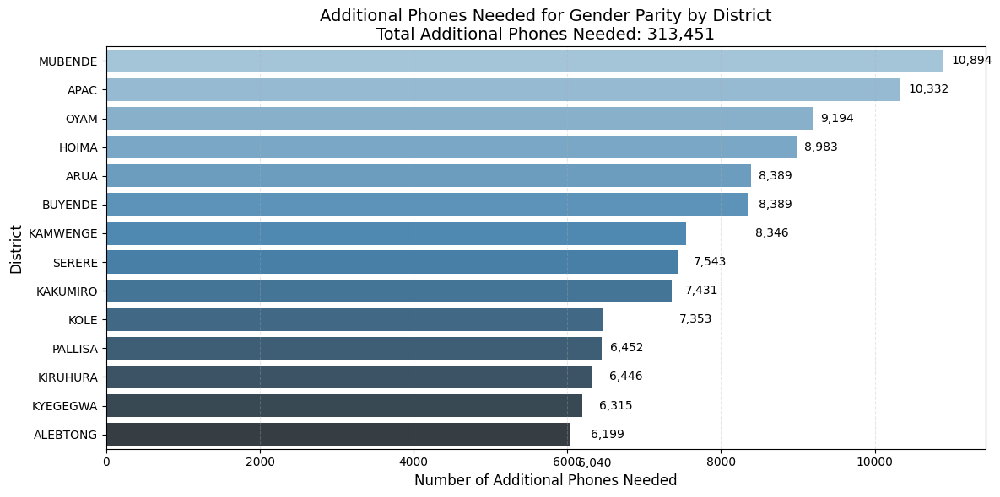

In [ ]:
# Calculate gender gap metrics
district_gaps = district_stats.copy()
district_gaps['Absolute_Gap'] = district_gaps['Females_18_30'] - district_gaps['Males_18_30']
district_gaps['Phones_Needed'] = district_gaps.apply(
    lambda x: abs(x['Absolute_Gap']) if x['Absolute_Gap'] < 0 else 0, axis=1
)

# Calculate total phones needed to close the gap
total_phones_needed = district_gaps['Phones_Needed'].sum()

# Create visualization
plt.figure(figsize=(12, 6))
sns.barplot(
    data=district_gaps.sort_values('Phones_Needed', ascending=False).head(15),
    x='Phones_Needed',
    y='District',
    palette='Blues_d'
)

plt.title(f'Additional Phones Needed for Gender Parity by District\nTotal Additional Phones Needed: {total_phones_needed:,}', fontsize=14)
plt.xlabel('Number of Additional Phones Needed', fontsize=12)
plt.ylabel('District', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.3)

# Add data labels
for i, row in enumerate(district_gaps.sort_values('Phones_Needed', ascending=False).head(15).iterrows()):
    plt.text(
        row[1]['Phones_Needed'] + 100,
        i,
        f"{row[1]['Phones_Needed']:,.0f}",
        va='center'
    )

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Inclusivity/My data/code/figs/mobile_owenership/phones_needed_for_parity.png', dpi=300, bbox_inches='tight')
plt.show()